In [1]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("TORCH_VERSION:", TORCH_VERSION, "; CUDA_VERSION:", CUDA_VERSION)

!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 18.1 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
TORCH_VERSION: 2.6 ; CUDA_VERSION: cu124
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-9k9me3k8
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-9k9me3k8
  Resolved https://github.com/facebookresearch/detectron2.git to commit b15f64ec4429e23a148972175a0207c5a9ab84cf
  Preparing metadata (setup.py) ... done
     ━━━━━━━━

In [2]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [3]:
!curl -L "https://app.roboflow.com/ds/u48ZZGEkWA?key=ayzHCo2TZG" > roboflow.zip
!unzip roboflow.zip
!rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   1533      0 --:--:-- --:--:-- --:--:--  1534
100 38.6M  100 38.6M    0     0  6607k      0  0:00:05  0:00:05 --:--:-- 9429k
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
   creating: test/
 extracting: test/DJI_0257_JPG.rf.c7f80ef88323b7a99b9a9adc1edfcda4.jpg  
 extracting: test/DJI_0265_JPG.rf.ab5fcd38ea6c4c130e93fa66039105ea.jpg  
 extracting: test/DJI_0269_JPG.rf.f10792fa575f755b64ea024af19379f3.jpg  
 extracting: test/DJI_0275_JPG.rf.c105562c37c487f50c3cb8fd081d094d.jpg  
 extracting: test/DJI_0293_JPG.rf.fae778f7ebadb2db45ecba2b9b475f15.jpg  
 extracting: test/DJI_0318_JPG.rf.bca8dd401ec9a1d2bbe0897030851f32.jpg  
 extracting: test/DJI_0321_JPG.rf.7adc083cd0c194461103d765575d2270.jpg  
 extracting: test/DJI_0323_JPG.rf.f2304ac2c8f20ff659ae6

In [4]:
import json

def fix_categories(file_path):
    with open(file_path, 'r') as f:
        data = json.load(f)

    # Set all annotations to class 0
    for ann in data["annotations"]:
        ann["category_id"] = 0

    # Define one class: box
    data["categories"] = [{"id": 0, "name": "box"}]

    with open(file_path, 'w') as f:
        json.dump(data, f, indent=4)

fix_categories("/content/train/_annotations.coco.json")
fix_categories("/content/test/_annotations.coco.json")


In [5]:
# Unregister if already exists
from detectron2.data import DatasetCatalog, MetadataCatalog

if "my_dataset_train" in DatasetCatalog.list():
    DatasetCatalog.remove("my_dataset_train")
    MetadataCatalog.remove("my_dataset_train")

if "my_dataset_test" in DatasetCatalog.list():
    DatasetCatalog.remove("my_dataset_test")
    MetadataCatalog.remove("my_dataset_test")


In [6]:
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# Remove existing registration if needed
if "my_dataset_train" in DatasetCatalog.list():
    DatasetCatalog.remove("my_dataset_train")
    MetadataCatalog.remove("my_dataset_train")

if "my_dataset_test" in DatasetCatalog.list():
    DatasetCatalog.remove("my_dataset_test")
    MetadataCatalog.remove("my_dataset_test")

# Register fresh
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [06/26 14:13:41 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 14:13:41 d2.data.datasets.coco]: Loaded 600 images in COCO format from /content/train/_annotations.coco.json


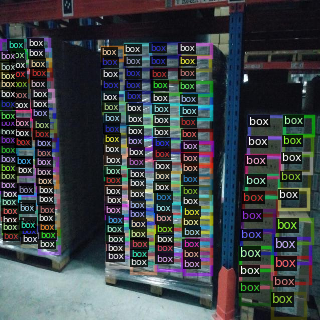

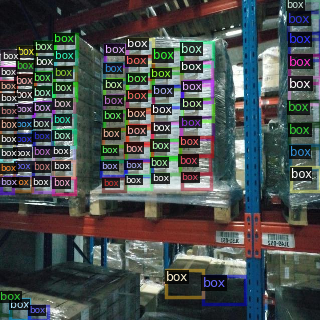

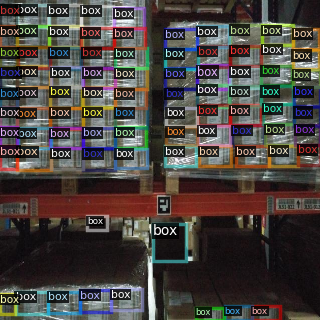

In [7]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [8]:
import json

with open("/content/train/_annotations.coco.json") as f:
    data = json.load(f)

category_ids = [cat["id"] for cat in data["categories"]]
print(f"Category IDs: {category_ids}")
print(f"Number of categories: {len(category_ids)}")


Category IDs: [0]
Number of categories: 1


In [9]:
with open("/content/train/_annotations.coco.json") as f:
    data = json.load(f)

category_ids = [cat["id"] for cat in data["categories"]]
print(f"Category IDs: {category_ids}")
print(f"Number of categories: {len(category_ids)}")


Category IDs: [0]
Number of categories: 1


In [10]:
category_names = [cat["name"] for cat in data["categories"]]
print("Category names:", category_names)
print("Are IDs 0-indexed and contiguous?:", sorted(category_ids) == list(range(len(category_ids))))


Category names: ['box']
Are IDs 0-indexed and contiguous?: True


In [11]:
import os
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"


In [12]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025  # pick a good LR
cfg.SOLVER.MAX_ITER = 500   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[06/26 14:13:45 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:00, 215MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[06/26 14:13:47 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/26 14:13:58 d2.utils.events]:  eta: 0:02:56  iter: 19  total_loss: 3.038  loss_cls: 0.6902  loss_box_reg: 0.382  loss_rpn_cls: 1.755  loss_rpn_loc: 0.2095    time: 0.3825  last_time: 0.3110  data_time: 0.0153  last_data_time: 0.0131   lr: 9.7405e-05  max_mem: 1870M
[06/26 14:14:10 d2.utils.events]:  eta: 0:02:49  iter: 39  total_loss: 1.806  loss_cls: 0.5581  loss_box_reg: 0.671  loss_rpn_cls: 0.3412  loss_rpn_loc: 0.2209    time: 0.3789  last_time: 0.4685  data_time: 0.0074  last_data_time: 0.0115   lr: 0.00019731  max_mem: 1931M
[06/26 14:14:18 d2.utils.events]:  eta: 0:02:41  iter: 59  total_loss: 1.638  loss_cls: 0.5295  loss_box_reg: 0.7549  loss_rpn_cls: 0.2419  loss_rpn_loc: 0.158    time: 0.3831  last_time: 0.3388  data_time: 0.0083  last_data_time: 0.0048   lr: 0.0002972  max_mem: 1931M
[06/26 14:14:25 d2.utils.events]:  eta: 0:02:27  iter: 79  total_loss: 1.618  loss_cls: 0.5183  loss_box_reg: 0.7375  loss_rpn_cls: 0.2085  loss_rpn_loc: 0.174    time: 0.3757  last_time: 0

In [13]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [14]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)

[06/26 14:17:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [15]:
test_metadata = MetadataCatalog.get("my_dataset_test")

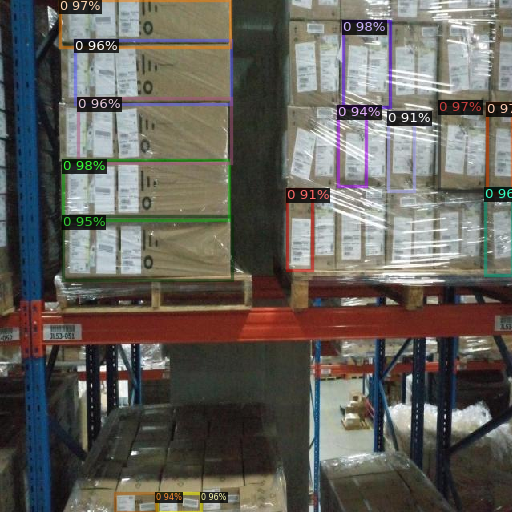

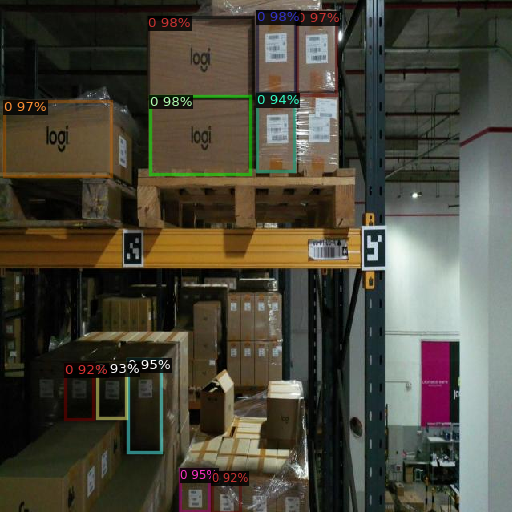

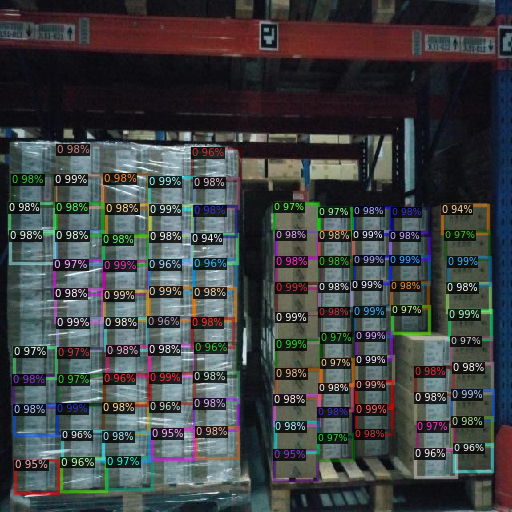

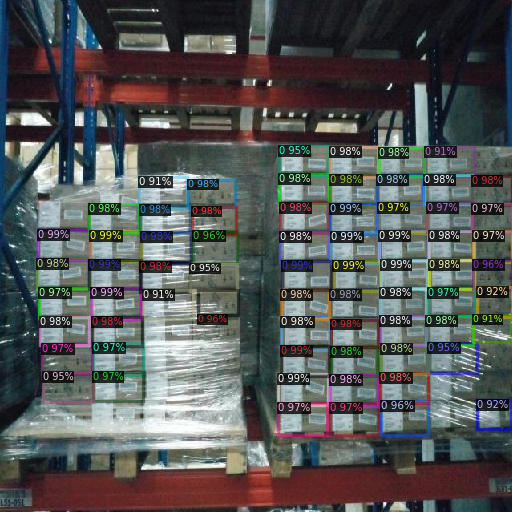

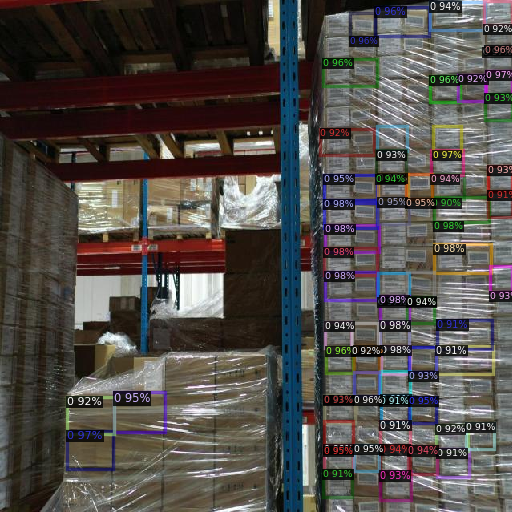

...

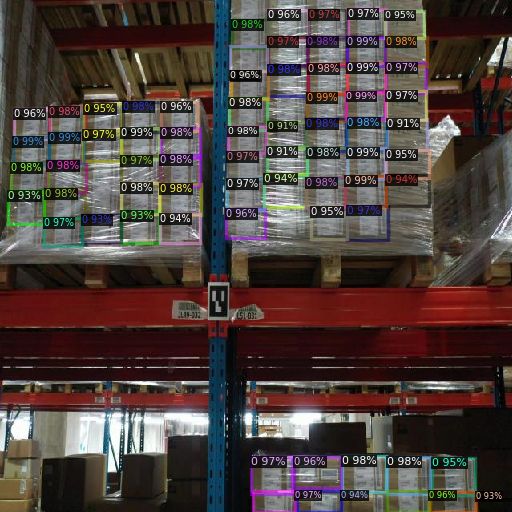

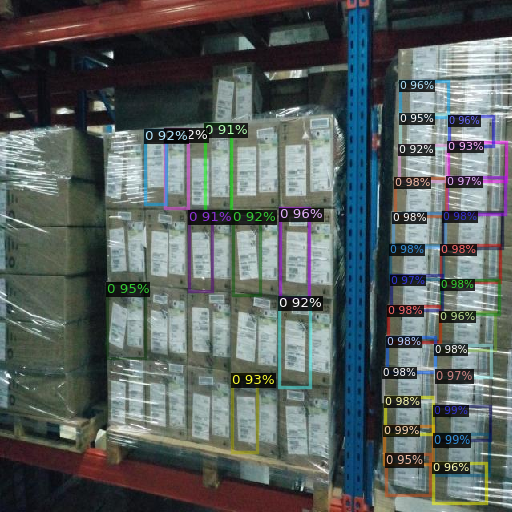

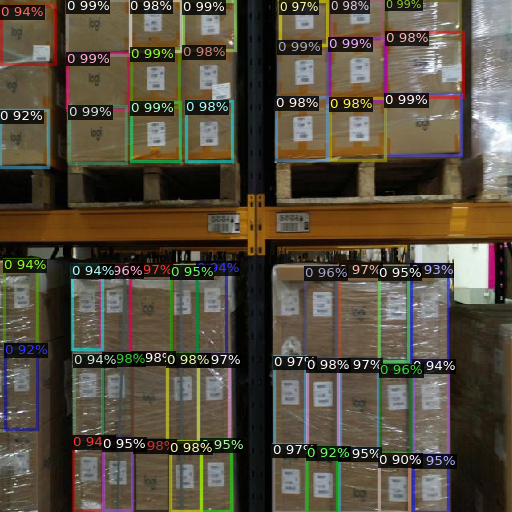

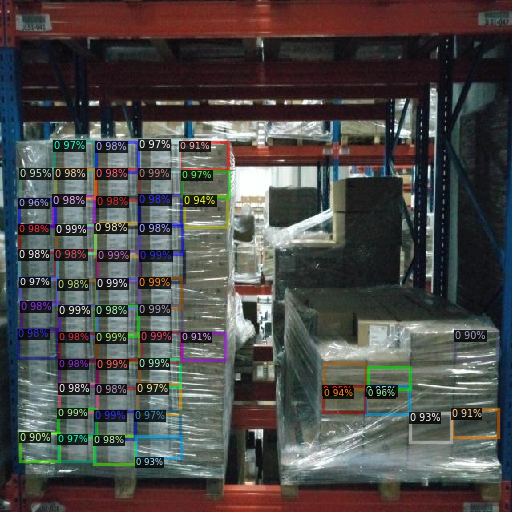

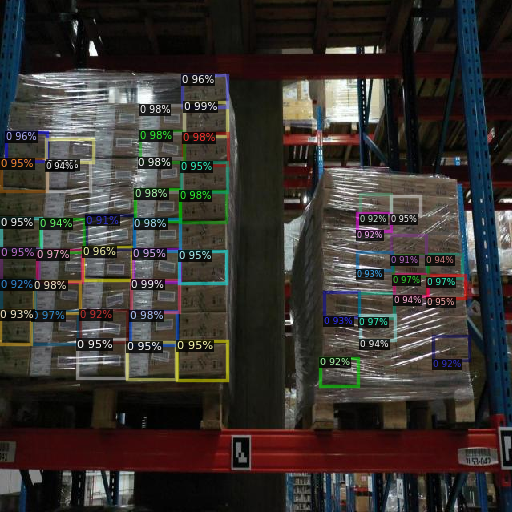

In [16]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

In [17]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_test", output_dir= "./output")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [06/26 14:17:29 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 14:17:29 d2.data.datasets.coco]: Loaded 23 images in COCO format from /content/test/_annotations.coco.json
[06/26 14:17:29 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    box     | 1546         |
|            |              |
[06/26 14:17:29 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[06/26 14:17:29 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[06/26 14:17:29 d2.data.common]: Serializing 23 elements to byte tensors and concatenating them all ...
[06/26 14:17:29 d2.data.common]: Serialized dataset takes 0.06 MiB
[06/26 14:17:29 d2.evaluation.evaluator]: Start inference on 23 batches
[06/26

In [18]:
f = open('config.yml', 'w')
f.write(cfg.dump())
f.close()

Saving test.jpeg to test.jpeg
Number of boxes detected: 6


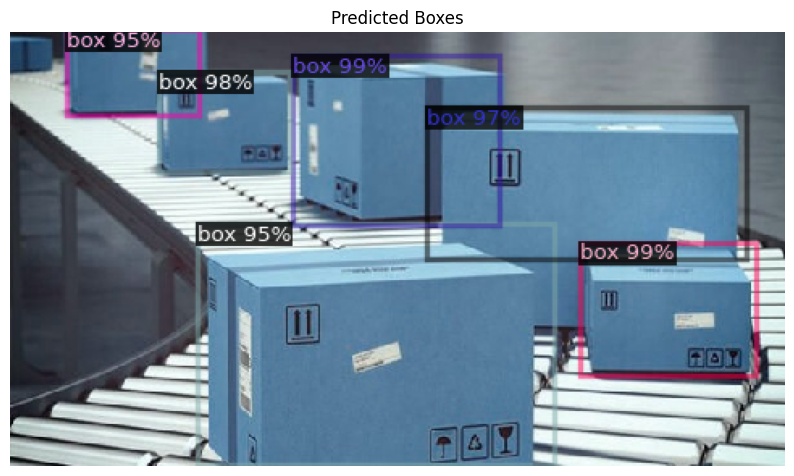

In [19]:
from google.colab import files
from PIL import Image
import matplotlib.pyplot as plt

# Upload an image
uploaded = files.upload()

for fn in uploaded.keys():
    # Read the image
    image_path = fn
    im = cv2.imread(image_path)

    # Run prediction
    outputs = predictor(im)
    instances = outputs["instances"].to("cpu")

    # 🧮 Count detected boxes
    num_boxes = len(instances)
    print(f"Number of boxes detected: {num_boxes}")

    # Visualize results
    v = Visualizer(im[:, :, ::-1], metadata=test_metadata, scale=0.8)
    out = v.draw_instance_predictions(instances)

    # Show the result
    result_image = out.get_image()[:, :, ::-1]
    plt.figure(figsize=(10, 8))
    plt.imshow(result_image)
    plt.axis('off')
    plt.title("Predicted Boxes")
    plt.show()


In [20]:
import numpy as np
import cv2
import json
import os
from detectron2.structures import Boxes, pairwise_iou
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.utils.visualizer import Visualizer
from tabulate import tabulate
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# --- IoU computation ---
def compute_iou(box1, box2):
    xi1 = max(box1[0], box2[0])
    yi1 = max(box1[1], box2[1])
    xi2 = min(box1[2], box2[2])
    yi2 = min(box1[3], box2[3])
    inter_area = max(xi2 - xi1, 0) * max(yi2 - yi1, 0)
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union_area = box1_area + box2_area - inter_area
    return inter_area / union_area if union_area > 0 else 0

# --- Ground truth extraction ---
def get_ground_truth(dataset_dicts):
    gt = {}
    for d in dataset_dicts:
        gt[d["file_name"]] = [ann["bbox"] for ann in d["annotations"]]
    return gt

# --- Convert COCO bbox format to XYXY ---
def convert_to_xyxy(box):
    return [box[0], box[1], box[0] + box[2], box[1] + box[3]]

# --- Load dataset and metadata ---
dataset_dicts = DatasetCatalog.get("my_dataset_test")
ground_truth = get_ground_truth(dataset_dicts)

# Ensure predictor and cfg are defined
# predictor = DefaultPredictor(cfg)
# cfg must be set correctly before this script runs

TP = 0
FP = 0
FN = 0
ious_all = []

# --- Evaluation loop ---
for d in dataset_dicts:
    img = cv2.imread(d["file_name"])
    gt_boxes = [convert_to_xyxy(b) for b in ground_truth[d["file_name"]]]

    outputs = predictor(img)
    pred_boxes = outputs["instances"].pred_boxes.tensor.cpu().numpy()

    matched_gt = set()
    for pred_box in pred_boxes:
        matched = False
        for i, gt_box in enumerate(gt_boxes):
            if i in matched_gt:
                continue
            iou = compute_iou(pred_box, gt_box)
            if iou >= 0.5:
                TP += 1
                matched_gt.add(i)
                ious_all.append(iou)
                matched = True
                break
        if not matched:
            FP += 1
    FN += len(gt_boxes) - len(matched_gt)

# --- Custom metrics ---
precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
map_50 = np.mean(ious_all) if ious_all else 0

# --- COCOEvaluator for mAP@0.5:0.95 ---
evaluator = COCOEvaluator("my_dataset_test", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
results = inference_on_dataset(predictor.model, val_loader, evaluator)

map_50_95 = results["bbox"]["AP"]
if map_50_95 > 1:
    map_50_95 /= 100  # Convert from percentage to [0, 1] scale

# --- Display metrics ---
metrics_table = [
    ["Precision", round(precision, 3)],
    ["Recall", round(recall, 3)],
    ["mAP@0.5 (custom IoU avg)", round(map_50, 3)],
    ["mAP@0.5:0.95 (COCO)", round(map_50_95, 3)]
]
print(tabulate(metrics_table, headers=["Metric", "Value"], tablefmt="grid"))


WARNING [06/26 14:18:31 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 14:18:31 d2.data.datasets.coco]: Loaded 23 images in COCO format from /content/test/_annotations.coco.json
WARNING [06/26 14:18:34 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 14:18:34 d2.data.datasets.coco]: Loaded 23 images in COCO format from /content/test/_annotations.coco.json
[06/26 14:18:34 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[06/26 14:18:34 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[06/26 14:18:34 d2.data.common]: Serializing 23 elements to byte tensors and concatenating them all ...
[06/26 14:18:34 d2.data.common]: Serialized dataset takes 0.06 MiB
[06/26 14:18:34 d2.evaluatio

In [21]:
from detectron2.data import DatasetCatalog

train_count = len(DatasetCatalog.get("my_dataset_train"))
test_count = len(DatasetCatalog.get("my_dataset_test"))

print(f"📸 Training images: {train_count}")
print(f"🧪 Testing images: {test_count}")

WARNING [06/26 14:18:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 14:18:37 d2.data.datasets.coco]: Loaded 600 images in COCO format from /content/train/_annotations.coco.json
WARNING [06/26 14:18:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/26 14:18:37 d2.data.datasets.coco]: Loaded 23 images in COCO format from /content/test/_annotations.coco.json
📸 Training images: 600
🧪 Testing images: 23
